In [227]:
%%time
import numpy as np
import scanpy as sc
import os
import pandas as pd
import bbknn

sc.settings.verbosity = 4                
sc.settings.set_figure_params(80)                 
sc.settings.file_format_figures = 'png'  
sc.settings.savefigs = False            
use_first_n_samples = 0
full_sparse = False


Wall time: 17 ms


# Batch 

In [3]:
def processing_batch(adata,neighbors = 15,key='batch',reso=0.4): # Higher resolution yields more leiden clusters 
    sc.pp.scale(adata, max_value=10)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.logging.print_memory_usage()
    sc.pp.neighbors(adata, n_neighbors=neighbors)
    sc.pl.pca_variance_ratio(adata, log=True)
    bbknn.bbknn(adata, batch_key=key, neighbors_within_batch=2, metric='euclidean', n_pcs=30,trim=None)
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=reso)
    sc.pl.umap(adata,color='leiden')

In [4]:
adata = sc.read('turtle_after_qc.h5ad') #adata after QC
# if the anndata object is processed and contains the raw data in adata.raw run -  adata = adata.raw.to_adata()

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


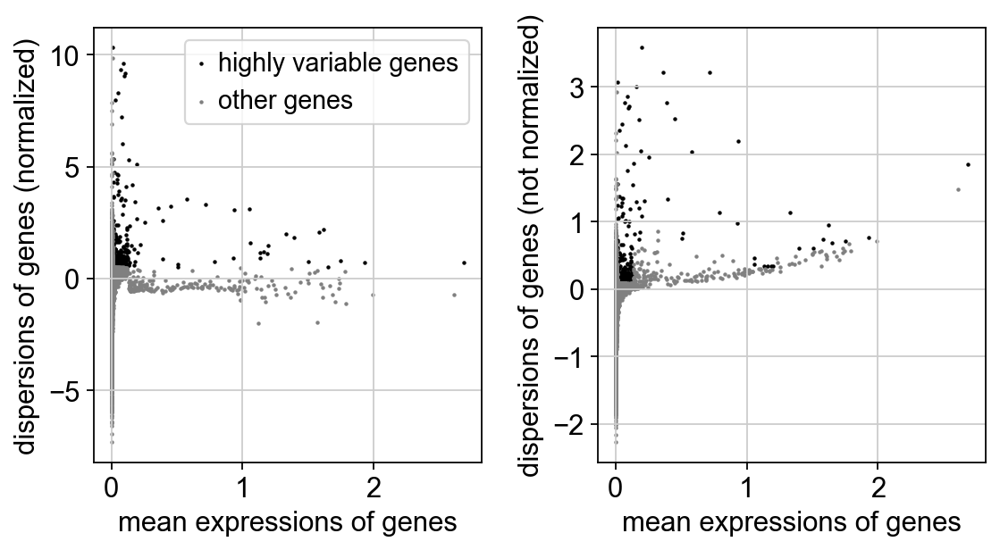

In [5]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)
adata.raw = adata
# adata = adata[:, adata.var.highly_variable] # For filtering non Highly variable genes. We usually keep all the genes. 

In [6]:
# sc.pp.regress_out(adata, ['total_counts','pct_counts_MT']) 

regressing out ['total_counts', 'pct_counts_MT']
    sparse input is densified and may lead to high memory use
    finished (0:02:30)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
    ... clipping at max_value 10
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
Memory usage: current 1.25 GB, difference +1.25 GB
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:17)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)


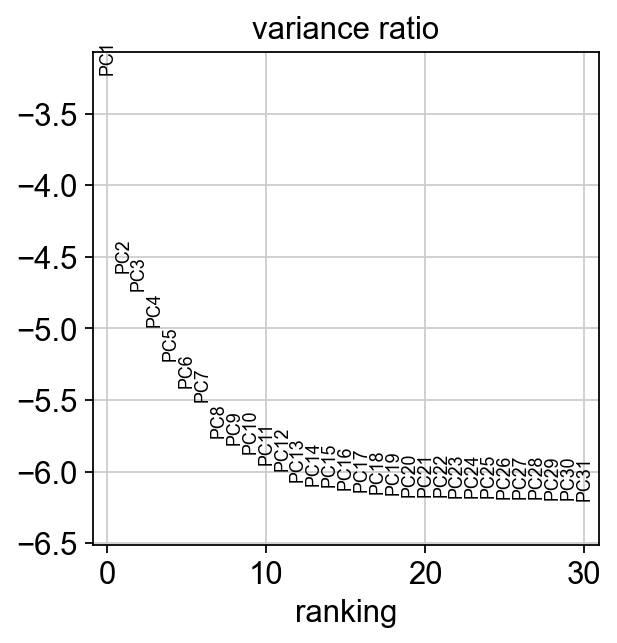

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


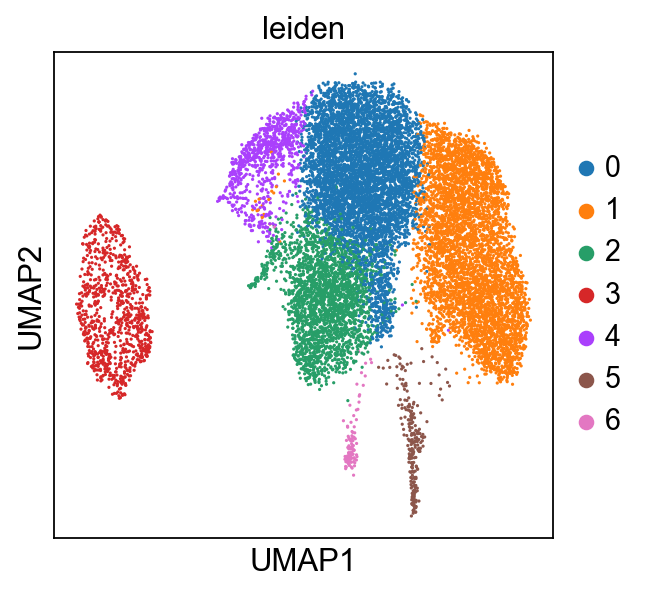

In [6]:
processing_batch(adata,key='treatment') # Starting with a low resolution of leiden clustering

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


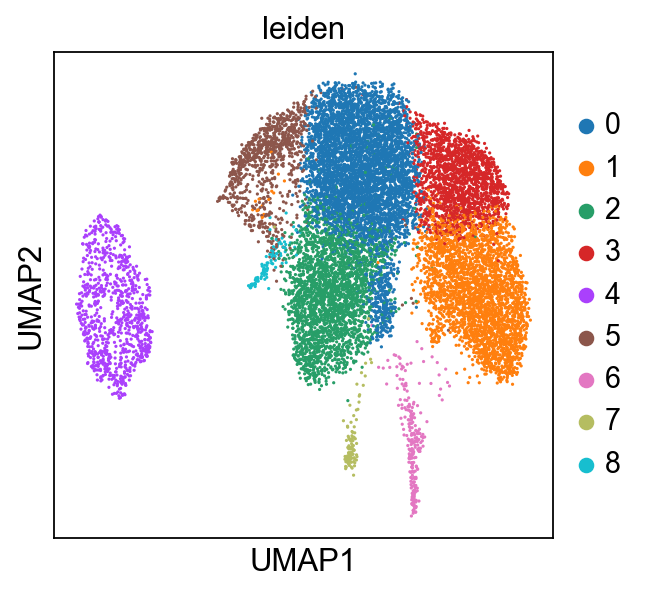

In [7]:
sc.tl.leiden(adata,resolution=0.6)
sc.pl.umap(adata, color = 'leiden')


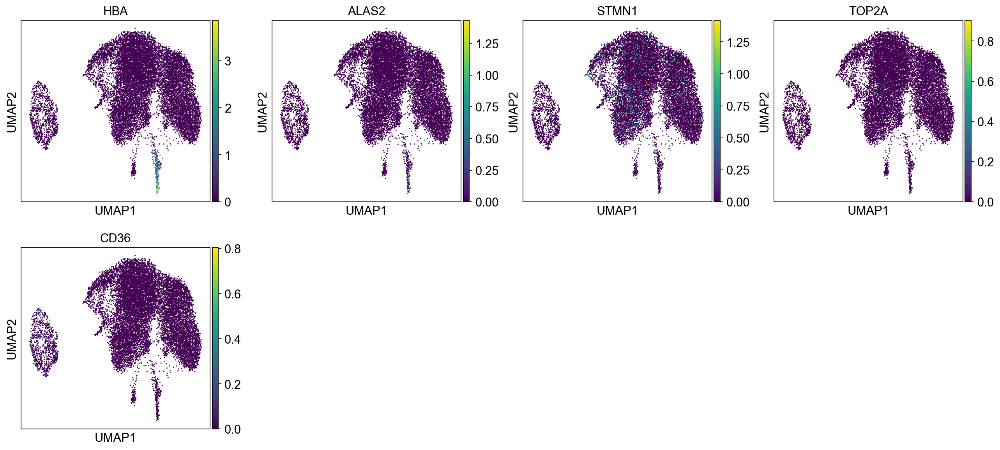

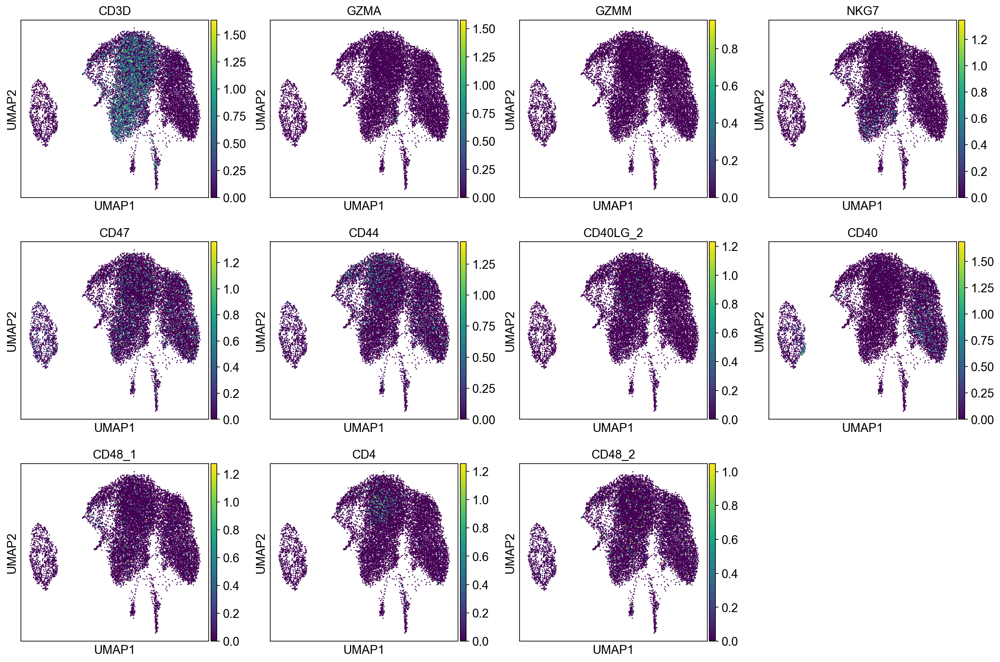

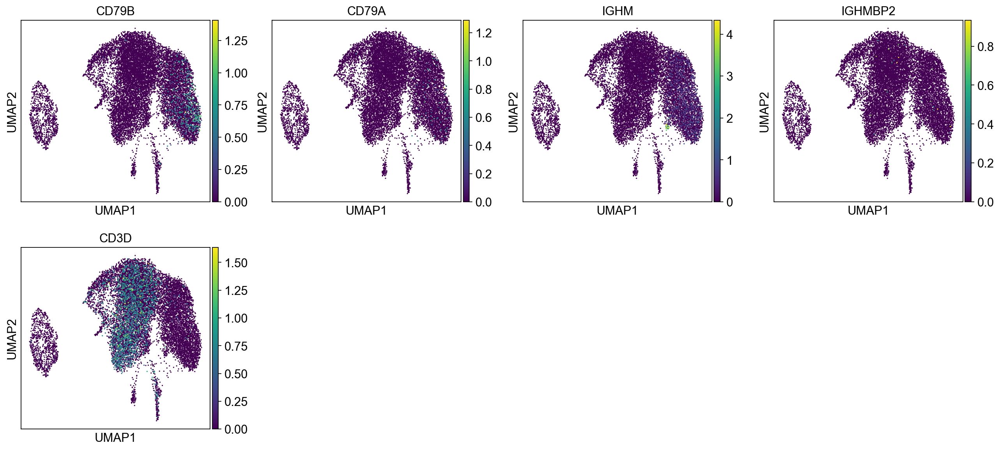

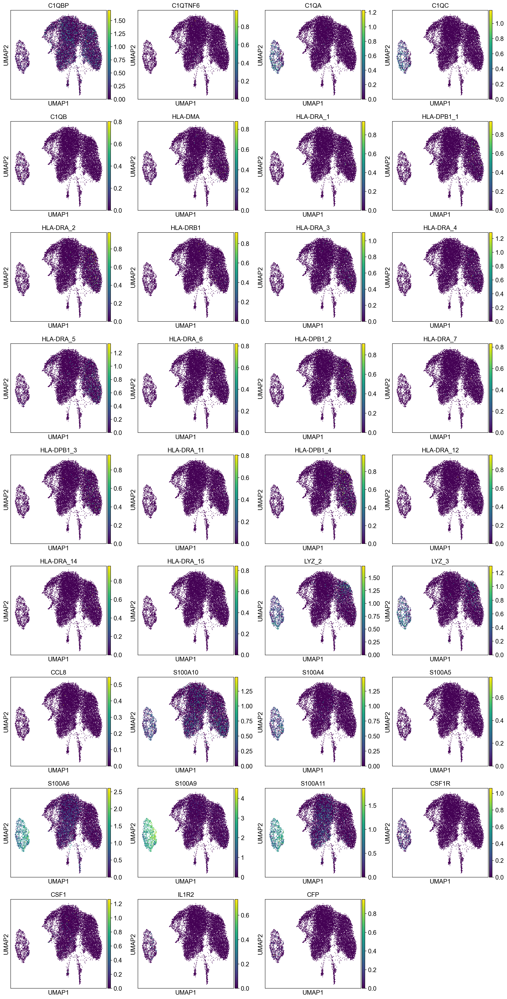

In [24]:
sc.pl.umap(adata, color = find_gene('hba')+find_gene('alas2')+ ['STMN1','TOP2A']+find_gene('CD36'))
sc.pl.umap(adata, color = find_gene('cd3d')+ find_gene('gzm')+['NKG7']+ find_gene('CD4'))
sc.pl.umap(adata, color = find_gene('cd79')+find_gene('ighm')+ find_gene('cd3d'))
sc.pl.umap(adata, color = find_gene('c1q')+find_gene('hla')+find_gene('lyz')+ find_gene('CCL8')+ find_gene('S100A')
+ find_gene('CSF1')+ find_gene('IL1R2')+ find_gene('CFP'))


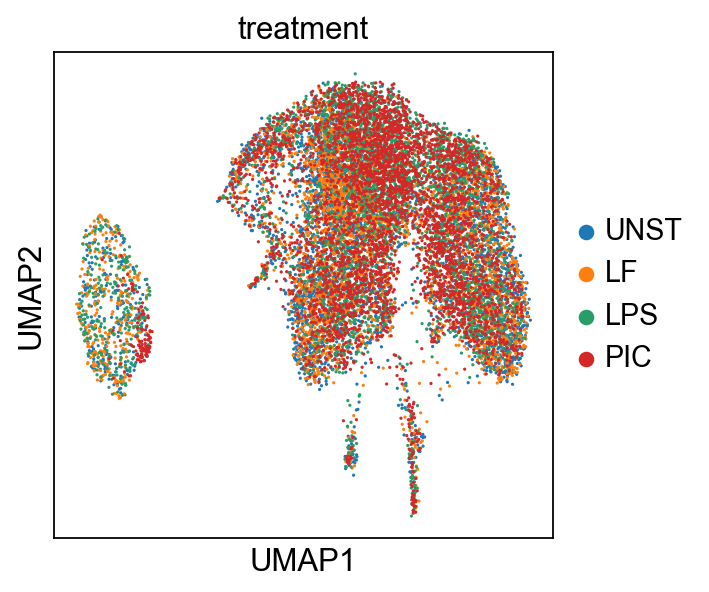

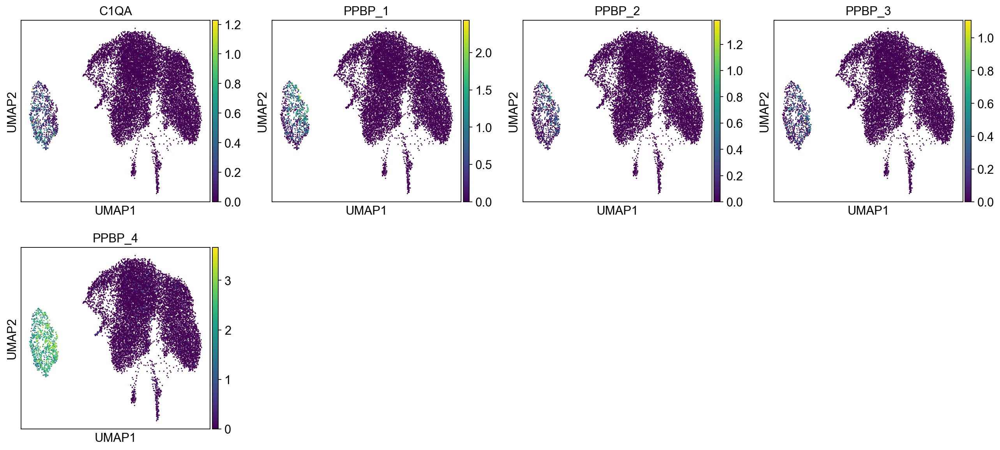

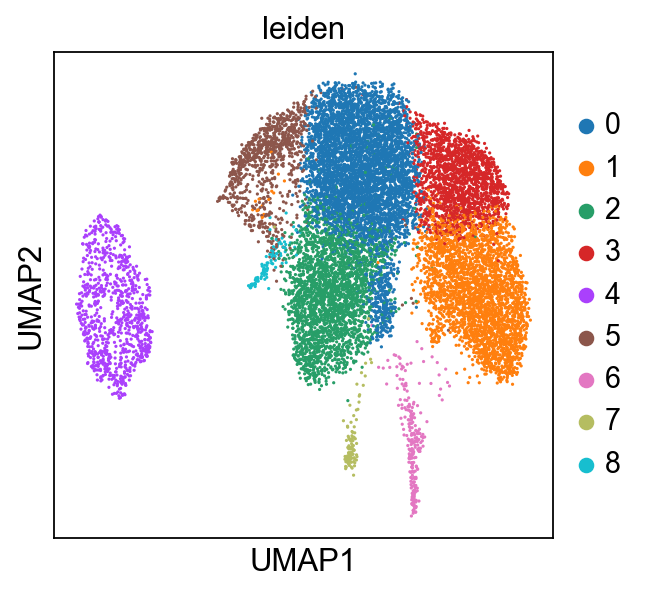

In [30]:
sc.pl.umap(adata, color = 'treatment')
# sc.pl.umap(adata, color = find_gene('cd79'))
sc.pl.umap(adata, color = ['C1QA']+find_gene('ppbp'))
sc.pl.umap(adata, color = 'leiden')

# sc.pl.umap(adata, color = find_gene('s100'))
# sc.pl.umap(adata, color = find_gene('lyz'))
# sc.pl.umap(adata, color = find_gene('CD74'))

ranking genes


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    consider 'leiden' groups:
    with sizes: [2246 1494 1438  675  540  429  109   60   36]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


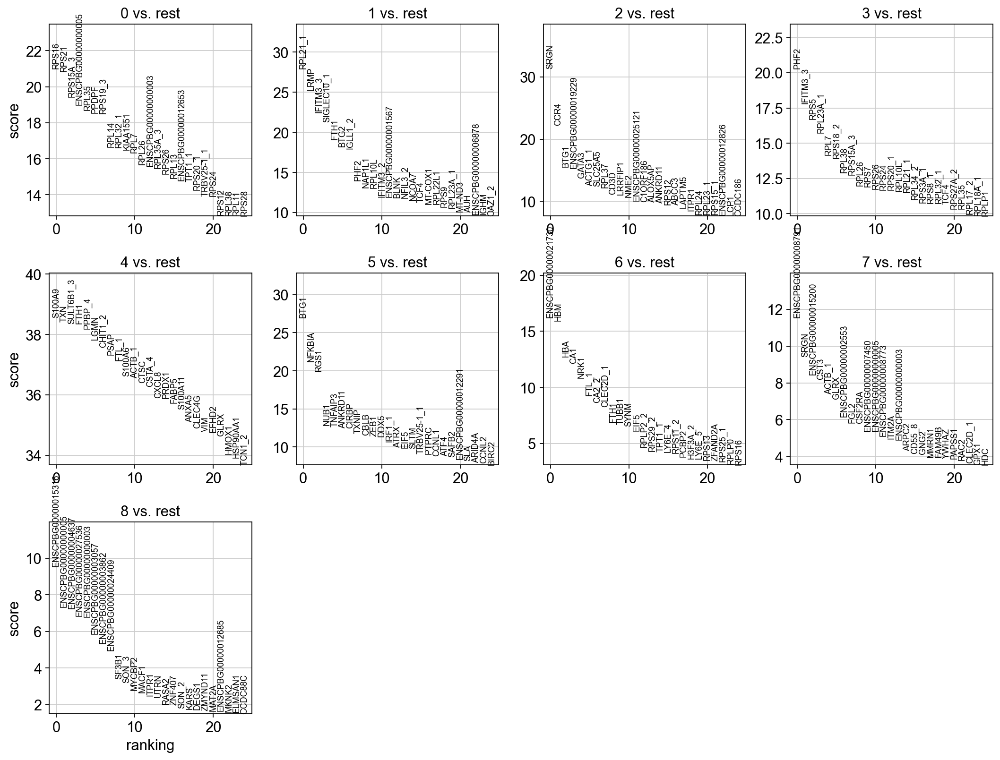

,0,1,2,3,4,5,6,7,8
0,RPS16,RPL21_1,SRGN,PHF2,S100A9,BTG1,ENSCPBG00000021730,ENSCPBG00000008791,ENSCPBG00000015316
1,RPS21,LRMP,CCR4,IFITM3_3,TXN,NFKBIA,HBM,SRGN,ENSCPBG00000000005
2,RPS15A_3,IFITM3_3,BTG1,RPS5,SULT6B1_3,RGS1,HBA,ENSCPBG00000015200,ENSCPBG00000004637
3,ENSCPBG00000000005,SIGLEC10_1,ENSCPBG00000019229,RPL23A_1,FTH1,NUB1,CA1,CST3,ENSCPBG00000027536
4,RPL35,FTH1,GATA3,RPL7,PPBP_4,TNFAIP3,NRK1,ACTB_1,ENSCPBG00000000003
5,PPDPF,BTG2,ACTG1_1,RPS18_2,LGMN,ANKRD11,FTL_1,GLRX,ENSCPBG00000003057
6,RPS19_3,IGLL1_2,SLC25A5,RPL38,CHIT1_2,CIRBP,CA2_2,ENSCPBG00000002553,ENSCPBG00000003862
7,RPL14,PHF2,RPL37,RPS15A_3,PSAP,TXNIP,CLEC2D_1,FGL2,ENSCPBG00000024409
8,RPL32_1,NAP1L1,CD3D,RPL26,FTL_1,CBLB,FTH1,CSF2RA,SF3B1
9,KIAA1551,RPL10L,LRRFIP1,RPS7,S100A6,ZEB1,TUBB1,ENSCPBG00000007450,SON_3


In [33]:
sc.tl.rank_genes_groups(unstlf, 'leiden', method='wilcoxon') # Can also be 'cell_type' once annotated
sc.pl.rank_genes_groups(unstlf, n_genes=25, sharey=False)
pd.set_option("display.max_columns", None)
pd.DataFrame(unstlf.uns['rank_genes_groups']['names']).head(20)

In [34]:
unstlf

AnnData object with n_obs × n_vars = 7027 × 13923
    obs: 'treatment', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'S_score', 'G2M_score', 'phase', 'leiden'
    var: 'gene_ids', 'n_cells', 'MT', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'treatment_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [ ]:
celltypes = {'0':'T_CD4','1':'','2':'','3':'','4':'Monocyte','5':'','6':'','7':'RBC','8':'','9':''}


# Rank genes - DE analysis

In [140]:
adata.write('turtle_mid_profiling.h5ad')

In [25]:
unstlf = adata[adata.obs.treatment.isin(['UNST','LF'])]

computing batch balanced neighbors


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors


	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


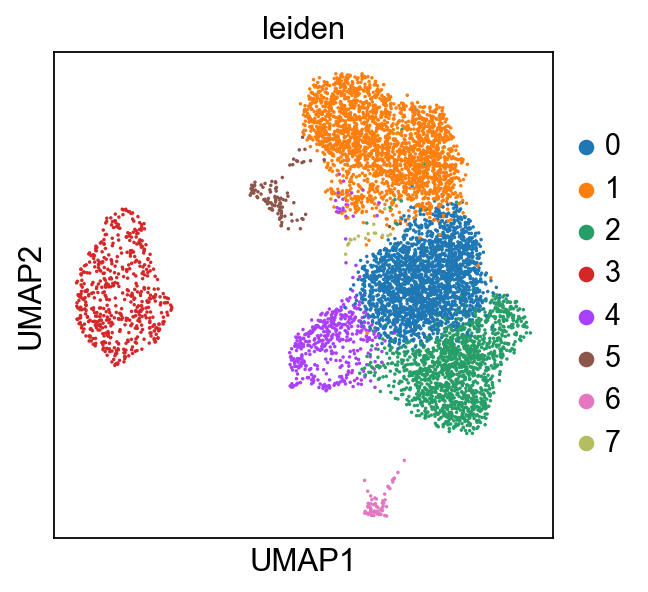

In [40]:
bbknn.bbknn(unstlf, batch_key='treatment', neighbors_within_batch=2, metric='euclidean', n_pcs=30,trim=None)
sc.tl.umap(unstlf)
sc.tl.leiden(unstlf, resolution=0.4)
sc.pl.umap(unstlf, color = 'leiden',size=10)

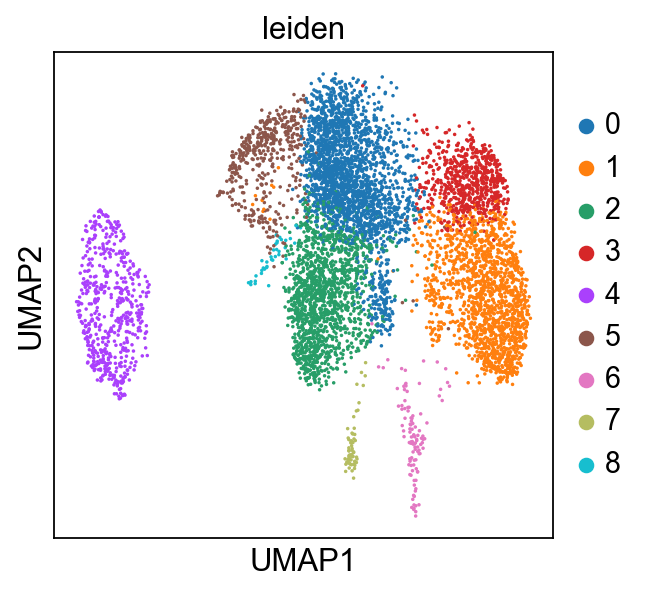

In [115]:
sc.pl.umap(unstlf, color = 'leiden',size=10)

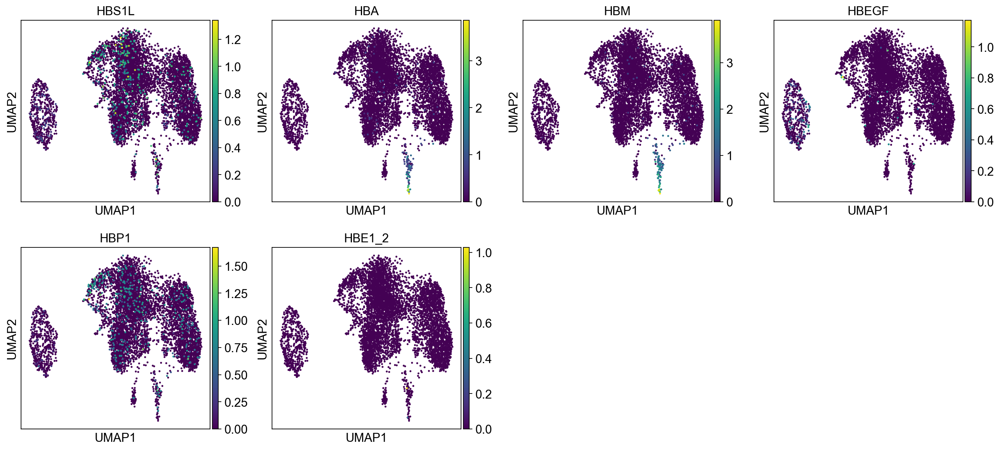

In [121]:
sc.pl.umap(unstlf, color = find_gene('HB'),size=20)

ranking genes
    consider 'leiden' groups:
    with sizes: [2265 2177 1429  538  438  100   64   16]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


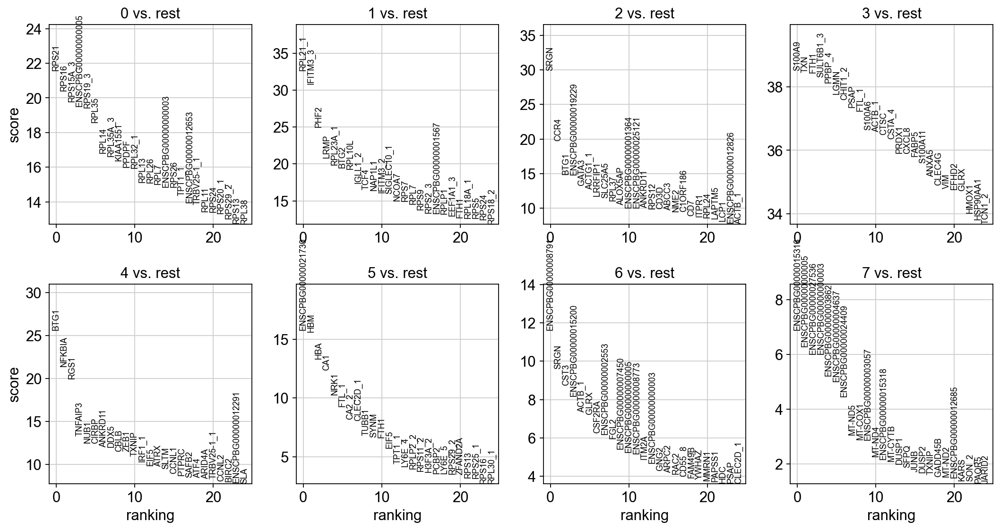

,0,1,2,3,4,5,6,7
0,RPS21,RPL21_1,SRGN,S100A9,BTG1,ENSCPBG00000021730,ENSCPBG00000008791,ENSCPBG00000015316
1,RPS16,IFITM3_3,CCR4,TXN,NFKBIA,HBM,SRGN,ENSCPBG00000000005
2,RPS15A_3,PHF2,BTG1,FTH1,RGS1,HBA,CST3,ENSCPBG00000027536
3,ENSCPBG00000000005,LRMP,ENSCPBG00000019229,SULT6B1_3,TNFAIP3,CA1,ENSCPBG00000015200,ENSCPBG00000000003
4,RPS19_3,RPL23A_1,GATA3,PPBP_4,NUB1,NRK1,ACTB_1,ENSCPBG00000003862
5,RPL35,BTG2,ACTG1_1,LGMN,CIRBP,FTL_1,GLRX,ENSCPBG00000004637
6,RPL14,RPL10L,LRRFIP1,CHIT1_2,ANKRD11,CA2_2,CSF2RA,ENSCPBG00000024409
7,RPL35A_3,IGLL1_2,SLC25A5,PSAP,DDX5,CLEC2D_1,ENSCPBG00000002553,MT-ND5
8,KIAA1551,TCF4,RPL37,FTL_1,CBLB,TUBB1,FGL2,MT-COX1
9,PPDPF,NAP1L1,ALOX5AP,S100A6,ZEB1,SYNM,ENSCPBG00000007450,ENSCPBG00000003057


In [41]:
sc.tl.rank_genes_groups(unstlf, 'leiden', method='wilcoxon') # Can also be 'cell_type' once annotated
sc.pl.rank_genes_groups(unstlf, n_genes=25, sharey=False)
pd.set_option("display.max_columns", None)
pd.DataFrame(unstlf.uns['rank_genes_groups']['names']).head(20)

## E2A, EBF1, PAX5

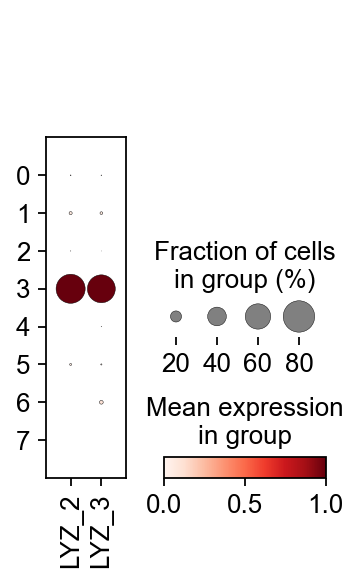

In [101]:
sc.pl.dotplot(unstlf,find_gene('lyz'),groupby='leiden',standard_scale='var')

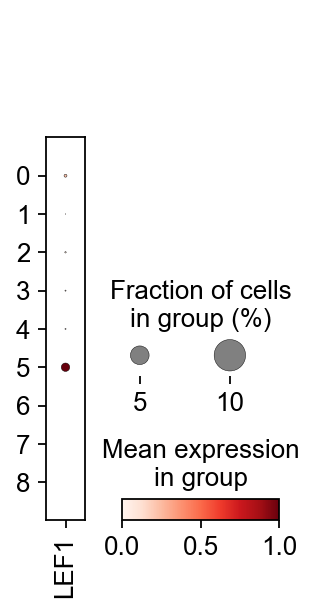

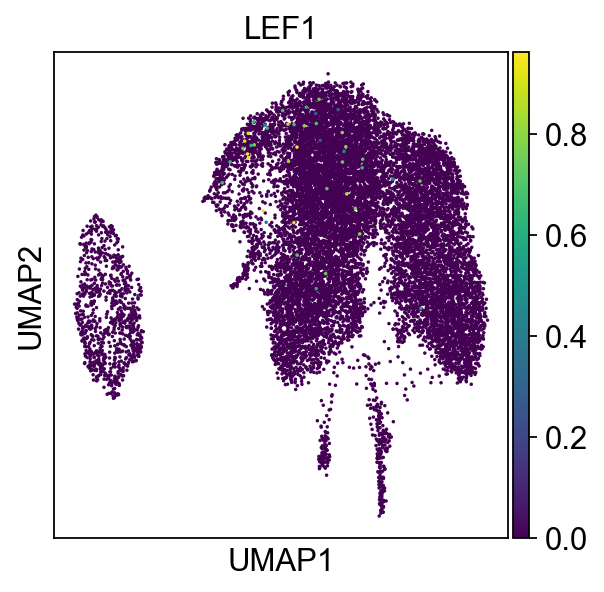

In [91]:
gene = 'lef'
sc.pl.dotplot(adata,find_gene(gene),groupby='leiden',standard_scale='var')
sc.pl.umap(adata, color = find_gene(gene),size=10)


In [ ]:
monocytes = ['MRC1_2','C1QA','C1QC','MAFB','TYROBP','LYZ_2','LYZ-3','SPI1','LGALS3','CSTA-4','S100A4','S100A9','CSF1R']
meutrophils = ['S100A10','CSF1','IL1R2','CFP'] # CFP marker for monocytes as well
MAFB_monocytes =['MAFB','DUSP1','JUNB','TNF','KLF4','NFKBIA','NFKBIZ']
T_cells = ['CD3D','CD247','TCF7','GPR183','GPR171']
B_cells = ['BANK1','CD79B','PLAC8','CD74','IGLL1-2','IGHM'] # ,'HLA-DRA-1' as well 
RBC = ['HBA','HBM','ALAS2'] 
RBC_pre = ['HBA','HBM','ALAS2','TOP2A','STMN1']
dc = ['XCR1','CD200','IL18','CST3','CSTA-1','SPIB','IRF8','HLA-DRA-1'] #ALL dcS
platelets = ['PLEK','CD36','SERPINE1','PECAM1','B2M']
# pDC = ['IRF8','SPIB','HLA-DRA-1','CD3D','IGHM','CST3'] # No XCR1, IL18 and CD200 like in other DC cluster

In [70]:
turt_komodo = [i for i in meutrophils+monocytes+MAFB_monocytes+dc+B_cells+T_cells+RBC+RBC_pre+platelets if i in adata.var_names]

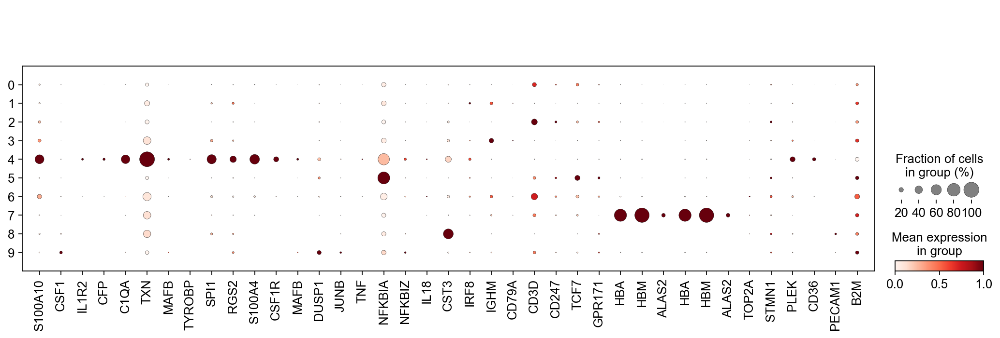

In [71]:
sc.pl.dotplot(adata,turt_komodo,groupby='leiden',standard_scale='var')


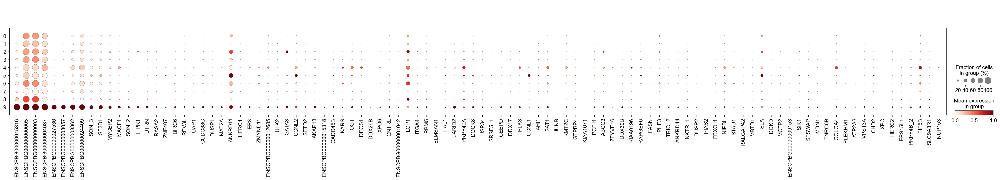

In [138]:
clusgene = list(pd.DataFrame(unstlf.uns['rank_genes_groups']['names']).head(100)['9'])
sc.pl.dotplot(adata,[i for i in clusgene if i.startswith('RP')==False],groupby='leiden',standard_scale='var')

In [9]:
adata.obs.leiden = adata.obs.leiden.astype('str')
for i in adata.obs_names:
    if adata.obs.at[i,'leiden'] ==0:
        adata.obs.at[i,'leiden'] = '0'
adata.obs.leiden = adata.obs.leiden.astype('category')

In [10]:
# ?FROM\ BATS
GENES = ["CSF3R",'CD300A', "CCRL2", "G0S2","FCGR3A",'FCGR3','CD16',"CX3CR1", #CD16 Mono 
           "CD14",'VCAN', "F13A1","MAFB","IFNB1", #CD14 Mono ;FCGR1A, S100A12 CLEC4A_LOC107498332
           "IL18",
            'CD1A','XCR1','CD200A','CD200','ITGAM', 
            "HLA-DRA", #cDC2
            'BATF3','LAMP3',
           "IRF8","TCF4",'IL7R',"CD4","FOXP3",'CTLA4','LEF1','CCR7','TCF7','CXCR6','CD8A','CD8B','CD7','GZMB','KLRD1','NCR1','CD3D','CD3E','CD3G',
'S100A8',
'FCGR4',
'LY6C2',
'FSCN1',
'CCR7',
'TCF4',
'BST2', 
'NKG7',
'NCR1',
'MS4A1','HLA-DPB1',
 'HLA-DRA',
 'HLA-DMA','CD74','ALAS2']

GENES_K =[i for i in GENES if i in adata.var_names]

In [434]:
clusgene = list(pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(50)['3'])

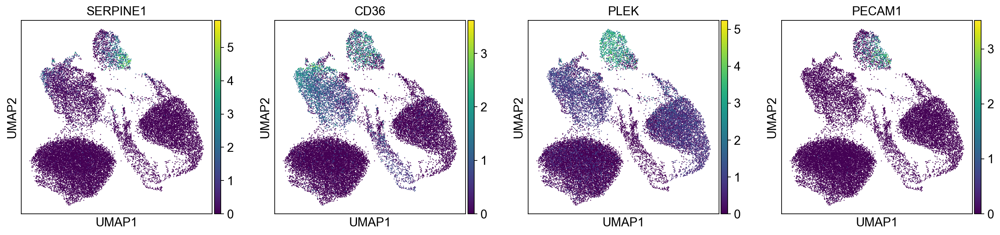

In [438]:
sc.pl.umap(adata,color = ['SERPINE1','CD36','PLEK','PECAM1'])

- Cluster 3 has a gprofiler file - full of coagulation and blood clotting terms, including platelete degranulation and aggregations (based on 50 DE genes).
- 1 DE gene found which coult possibly support it being platlets - SERPINE1 (by PangaoDB), CD36, PLEK 
- B2M, TMSB4X, ACTB - High level expression (mostly of B2M) is sometimes associated with Platlets. https://doi.org/10.1038/s41598-021-94003-z

 platlete_markers = ['PLEK','CD36','SERPINE1','B2M']

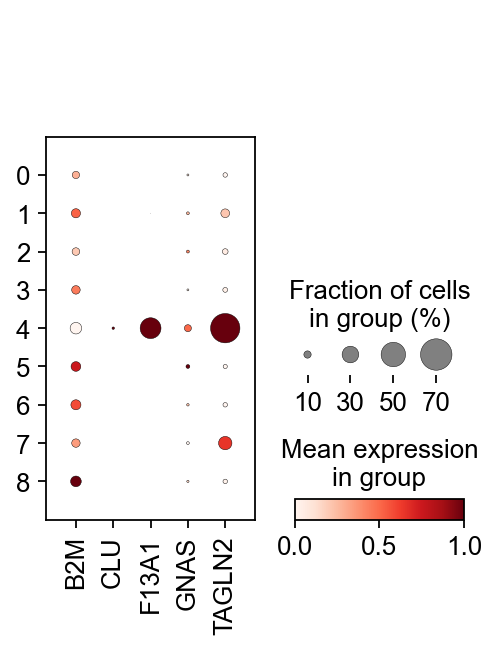

KeyError: 'SERPINE1'

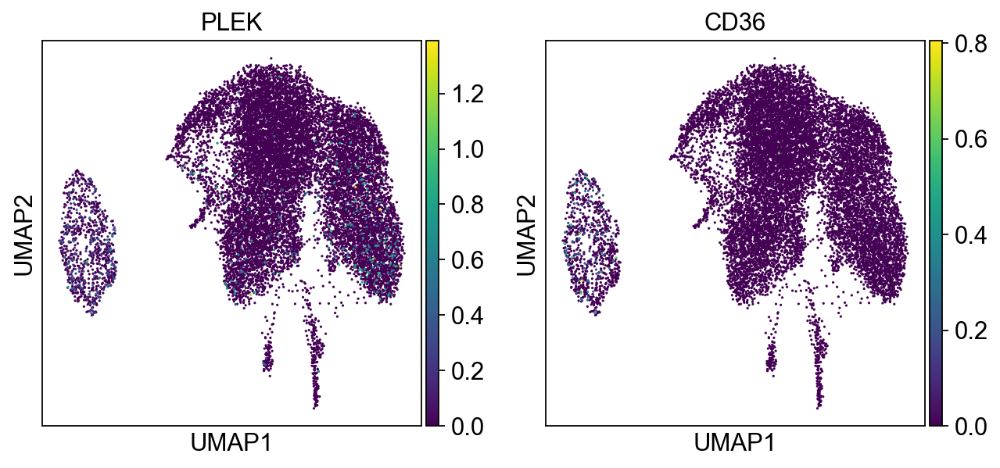

In [14]:
platlet = ['B2M','PPBP','TMSB4X','ACTB','FTL','CLU','PF4','F13A1','GNAS','SPARC','PTMA','TAGLN2','OAZ1','OST4']
platlet = [i for i in platlet if i in adata.var_names]
sc.pl.dotplot(adata,platlet,groupby='leiden',standard_scale='var')
sc.pl.umap(adata, color = ['PLEK','CD36','SERPINE1','B2M'])

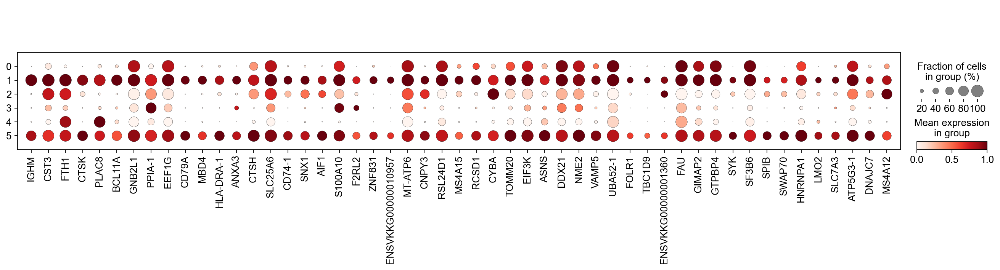

In [353]:
# sc.tl.leiden(adata,resolution=0.4)
clusgene = list(pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(100)['1'])
sc.pl.dotplot(adata,[i for i in clusgene if i.startswith('RP')==False],groupby='leiden',standard_scale='var')

# MARKERS

In [9]:
monocytes = ['MRC1','CCL8-1','C1QA','TXN','MAFB','TYROBP','LYZ','SPI1','LGALS3','RGS2','CSTA-1','S100A4','CSF1R']
meutrophils = ['S100A10','CSF1','IL1R2','CFP'] # CFP marker for monocytes as well
MAFB_monocytes =['MAFB','DUSP1','JUNB','TNF','KLF4','NFKBIA','NFKBIZ']
T_cells = ['CD3D','CD247','TCF7','GPR183','GPR171']
B_cells = ['IGHM','CD79A','PLAC8','CD74-1'] # ,'HLA-DRA-1' as well 
RBC = ['HBA','HBM','ALAS2'] 
RBC_pre = ['HBA','HBM','ALAS2','TOP2A','STMN1']
dc = ['XCR1','CD200','IL18','CST3','CSTA-1','SPIB','IRF8','HLA-DRA-1'] #ALL dcS
platelets = ['PLEK','CD36','SERPINE1','PECAM1','B2M']
# pDC = ['IRF8','SPIB','HLA-DRA-1','CD3D','IGHM','CST3'] # No XCR1, IL18 and CD200 like in other DC cluster

In [10]:
turt_komodo = [i for i in meutrophils+monocytes+MAFB_monocytes+dc+B_cells+T_cells+RBC+RBC_pre+platelets if i in adata.var_names]

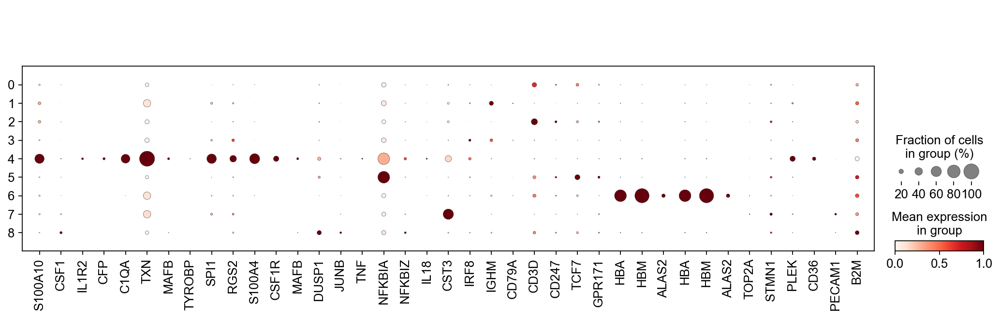

In [13]:
# cell_order = ['Heterophil','Monocyte','Monocyte_MRC1','Monocyte_CCL8','Monocyte_C1Q_CCL8','Monocyte_TXN','Monocyte_MAFB','cDC','B','T','RBC','Erythroid_precursor','Platelet']
sc.pl.dotplot(adata,turt_komodo,groupby='leiden',standard_scale='var')

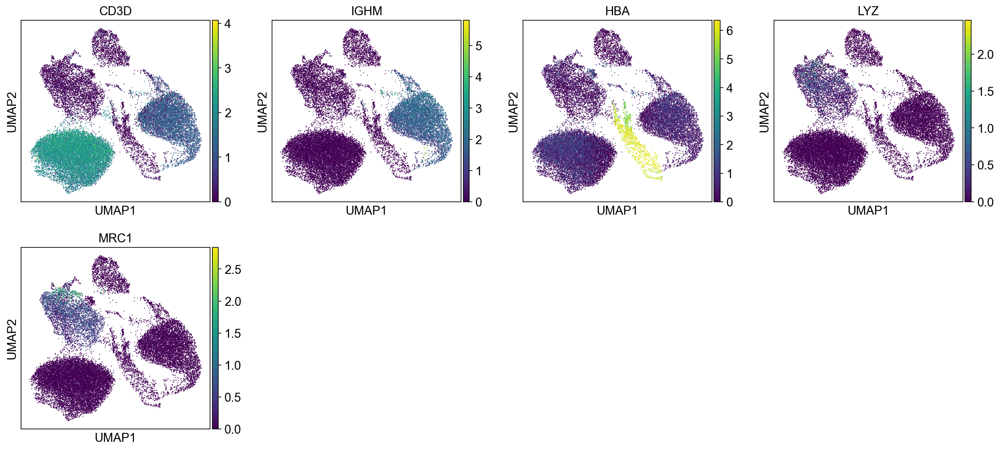

In [405]:
sc.pl.umap(adata,color=['CD3D','IGHM','HBA','LYZ','MRC1'])

In [138]:
celltype = {'6':'RBC'}

In [139]:
adata.obs['cell_type'] = adata.obs.leiden.map(celltype).astype('category')

# Sub-clustering - B + T


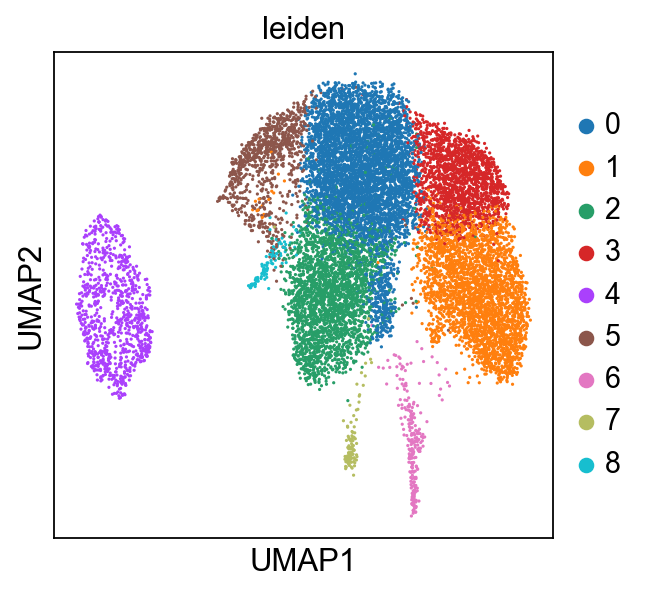

In [23]:
sc.pl.umap(adata,color='leiden')

In [192]:
clustert = adata[adata.obs.leiden.isin(['0','1','2','3','5','8'])]

computing batch balanced neighbors


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors


	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


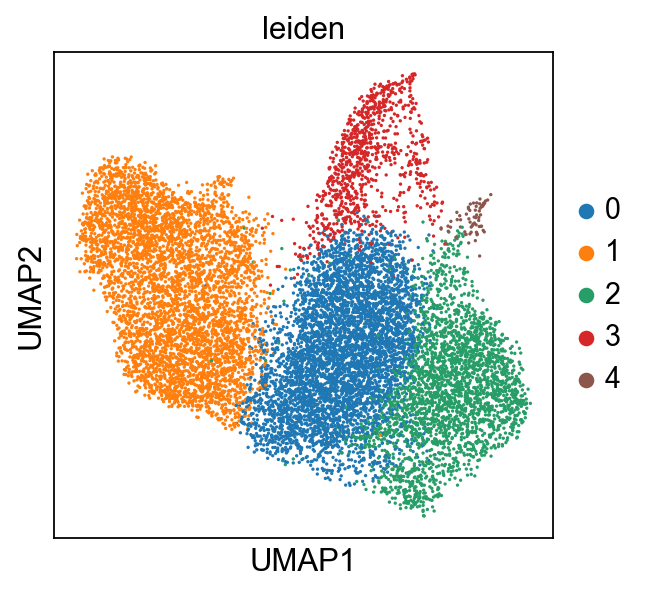

In [193]:
bbknn.bbknn(clustert, batch_key='treatment', neighbors_within_batch=2, metric='euclidean', n_pcs=30,trim=None)
sc.tl.umap(clustert)
sc.tl.leiden(clustert, resolution=0.4)
sc.pl.umap(clustert,color =['leiden'])

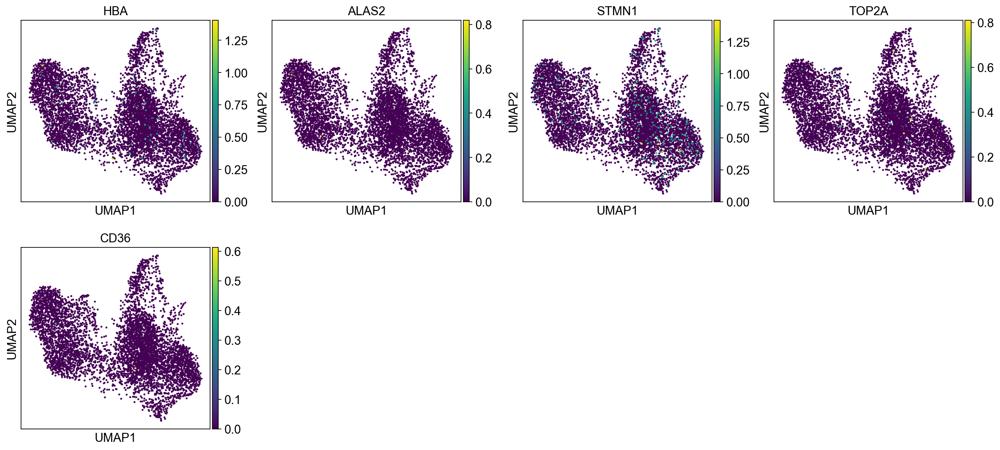

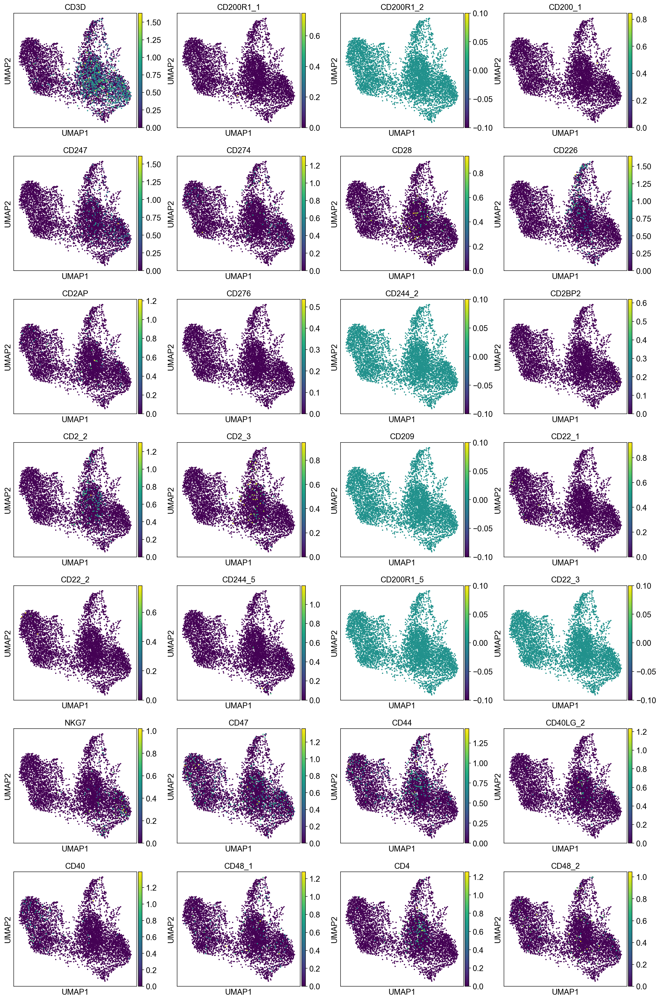

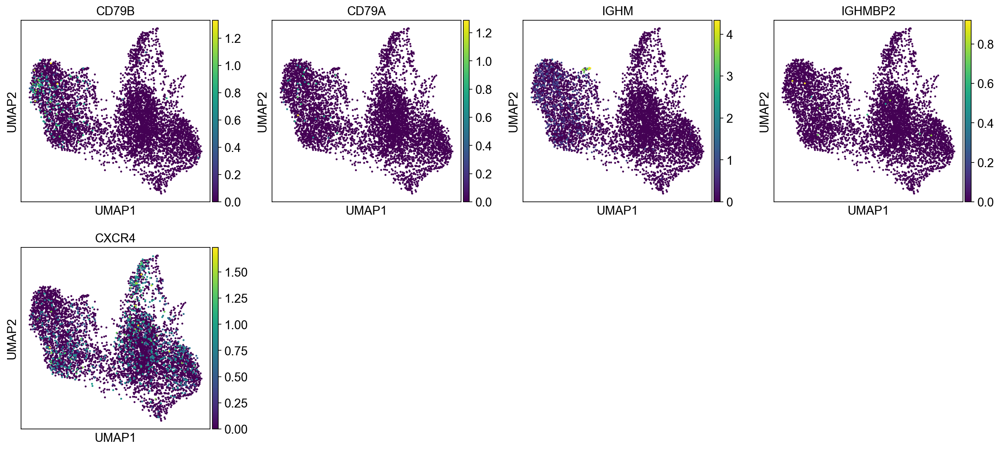

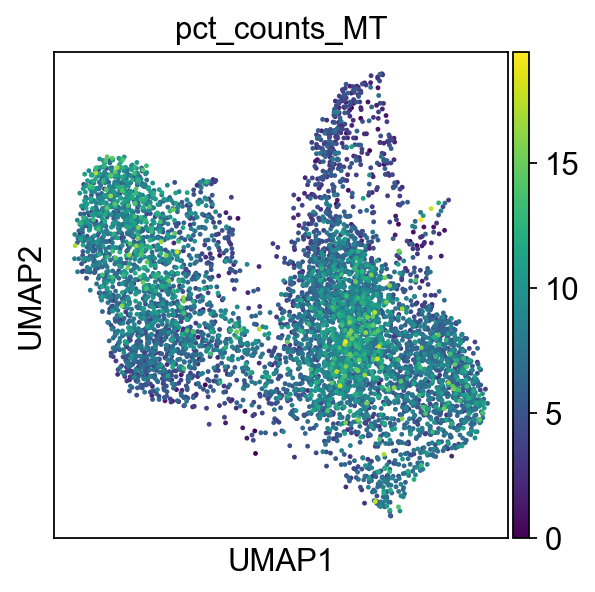

In [88]:
sc.pl.umap(clustert, color = find_gene('hba')+find_gene('alas2')+ ['STMN1','TOP2A']+find_gene('CD36'),size=20)
sc.pl.umap(clustert, color = find_gene('cd3d')+ find_gene('CD69')+find_gene('CD2')+['NKG7']+ find_gene('CD4'),size=20)
sc.pl.umap(clustert, color = find_gene('cd79')+find_gene('ighm')+ find_gene('cxcr4'),size=20)
sc.pl.umap(clustert,color =['pct_counts_MT'])

In [82]:
clustert = clustert[clustert.obs.treatment.isin(['UNST','LF'])]

In [57]:
clustert[:, clustert.var_names.str.startswith('RP')==False]

View of AnnData object with n_obs × n_vars = 6318 × 13765
    obs: 'treatment', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_MT', 'pct_counts_MT', 'S_score', 'G2M_score', 'phase', 'leiden'
    var: 'gene_ids', 'n_cells', 'MT', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'treatment_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [83]:
clustert = clustert[:, clustert.var_names.str.startswith('RP')==False]

ranking genes


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    consider 'leiden' groups:
    with sizes: [2224 2158 1467  447   22]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


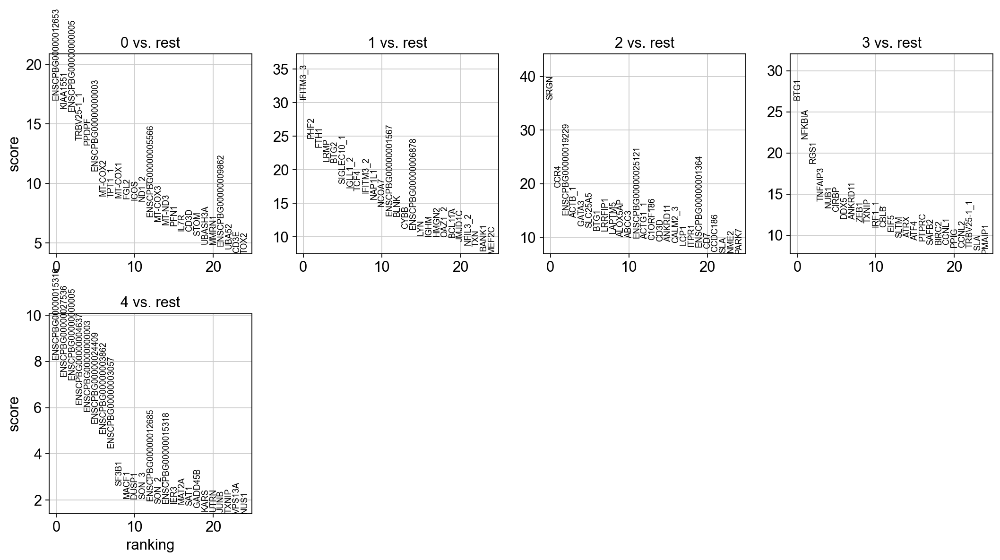

,0,1,2,3,4
0,ENSCPBG00000012653,IFITM3_3,SRGN,BTG1,ENSCPBG00000015316
1,KIAA1551,PHF2,CCR4,NFKBIA,ENSCPBG00000027536
2,ENSCPBG00000000005,FTH1,ENSCPBG00000019229,RGS1,ENSCPBG00000000005
3,TRBV25-1_1,LRMP,ACTB_1,TNFAIP3,ENSCPBG00000004637
4,PPDPF,BTG2,GATA3,NUB1,ENSCPBG00000000003
5,ENSCPBG00000000003,SIGLEC10_1,SLC25A5,CIRBP,ENSCPBG00000024409
6,MT-COX2,IGLL1_2,BTG1,DDX5,ENSCPBG00000003862
7,TPT1_1,TCF4,LRRFIP1,ANKRD11,ENSCPBG00000003057
8,MT-COX1,IFITM3_2,LAPTM5,ZEB1,SF3B1
9,FGL2,NAP1L1,ALOX5AP,TXNIP,MACF1


In [84]:
sc.tl.rank_genes_groups(clustert, 'leiden', method='wilcoxon',use_raw=False) # Can also be 'cell_type' once annotated
sc.pl.rank_genes_groups(clustert, n_genes=25, sharey=False)
pd.set_option("display.max_columns", None)
pd.DataFrame(clustert.uns['rank_genes_groups']['names']).head(20)

In [196]:
B = ['LRMP','IGLL1_2','BLNK','IGHM','BCL11A','CD74']
T = ['IL7R','CD3D','TRBV25-1_1','ICOS','CCR4'] # CCR4 T CELLS CLUS 2 
unkown_7SK = ['7SK'] #ENSCPBG00000015316

In [197]:
clusters_lymph = {'0':'T_1','1':'B','2':'T_2','3':'Unkown_RGS1','4':'unkown_7SK',}

In [ ]:
pd.DataFrame(clustert.uns['rank_genes_groups']['names']).head(20)

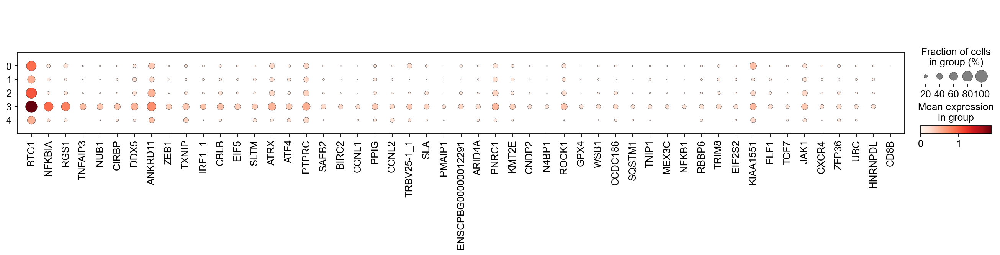

In [112]:
# sc.tl.leiden(clustert,resolution=0.4)
clusgene = list(pd.DataFrame(clustert.uns['rank_genes_groups']['names']).head(200)['3'])
sc.pl.dotplot(clustert,[i for i in clusgene[:50] if i.startswith('RP')==False]+['CD8B'],groupby='leiden',standard_scale=None)
# sc.pl.dotplot(clustert,['XCR1','CSTA-1','IRF8','CD200','HLA-DRA-1','IL18','FSCN1','TOP2A','STMN1','CD83','MARCKSL1','ALAS2','ENO1'],groupby='leiden',standard_scale='var')


In [198]:
clustert.obs['cell_type'] = clustert.obs.leiden.map(clusters_lymph).astype('category')

In [201]:
clustert.obs.drop(columns='leiden',inplace=True)

In [209]:
adata.obs['cell_type'] = 'RBC' # for cluster 6
adata.obs.update(clustert.obs)

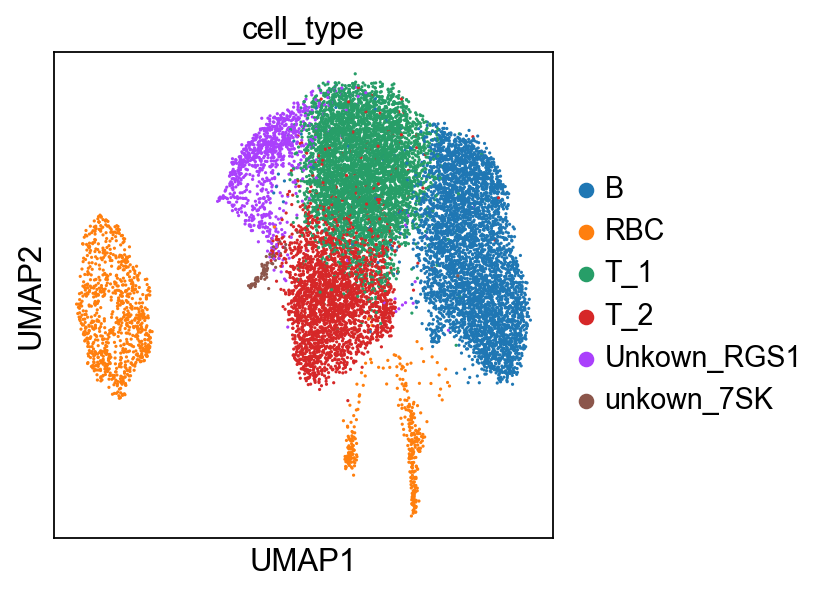

In [211]:
sc.pl.umap(adata,color='cell_type')

> In order to find more specific cell types known markers from  Elmentaite, R. et al. Cells of the human intestinal tract mapped across space and time. Nature 597, (2021) will be checked for expression in the sub clusters

# subclus myeloids

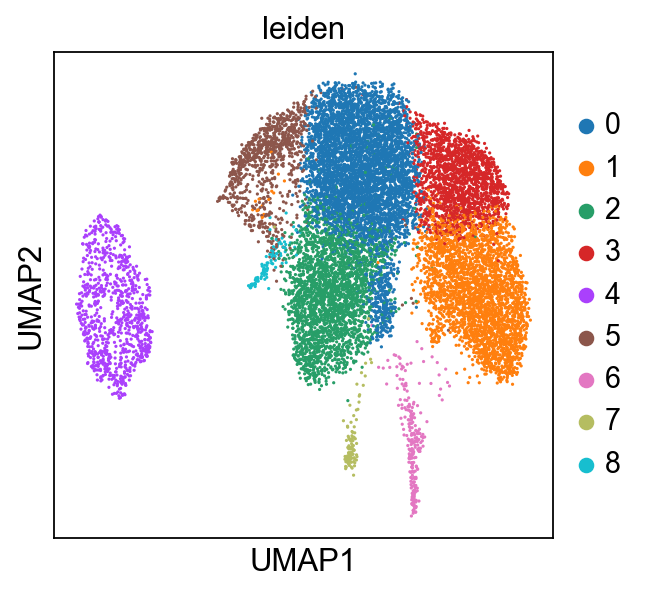

In [114]:
sc.pl.umap(adata,color='leiden')

In [217]:
clusterm = adata[adata.obs.leiden.isin(['4','7'])]

In [218]:
# clusterm = clusterm[clusterm.obs.treatment.isin(['UNST','LF'])]
clusterm = clusterm[:, clusterm.var_names.str.startswith('RP')==False]

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors


	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


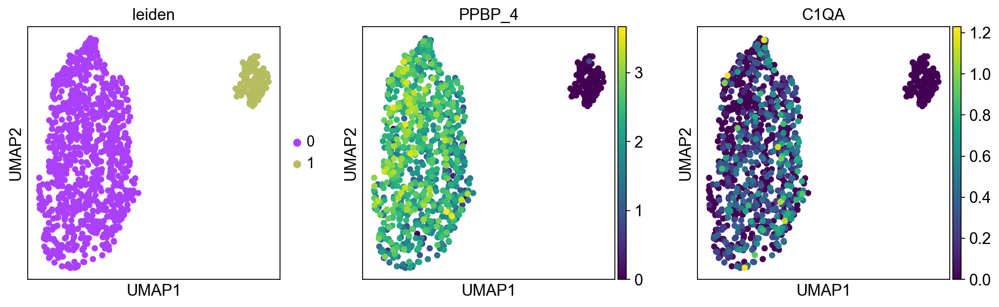

ranking genes
    consider 'leiden' groups:
    with sizes: [882 107]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


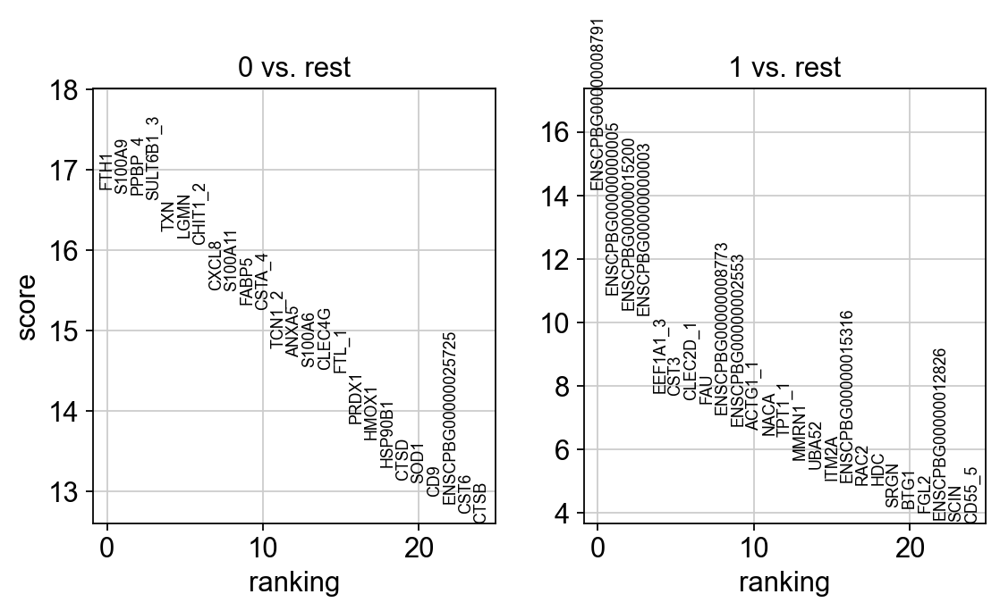

,0,1
0,FTH1,ENSCPBG00000008791
1,S100A9,ENSCPBG00000000005
2,PPBP_4,ENSCPBG00000015200
3,SULT6B1_3,ENSCPBG00000000003
4,TXN,EEF1A1_3
5,LGMN,CST3
6,CHIT1_2,CLEC2D_1
7,CXCL8,FAU
8,S100A11,ENSCPBG00000008773
9,FABP5,ENSCPBG00000002553


In [219]:
bbknn.bbknn(clusterm, batch_key='treatment', neighbors_within_batch=2, metric='euclidean', n_pcs=30,trim=None)
sc.tl.umap(clusterm)
sc.tl.leiden(clusterm, resolution=0.01)
sc.pl.umap(clusterm,color =['leiden','PPBP_4','C1QA',])

sc.tl.rank_genes_groups(clusterm, 'leiden', method='wilcoxon',use_raw=False) # Can also be 'cell_type' once annotated
sc.pl.rank_genes_groups(clusterm, n_genes=25, sharey=False)
pd.set_option("display.max_columns", None)
pd.DataFrame(clusterm.uns['rank_genes_groups']['names']).head(20)

In [ ]:
monocyte = ['C1QA','C1QC','LYZ_2','LYZ_3','S100A9','S100A11'] # Some PPBP which is a marker for platelets for some reason 
dc_maybe = ['CST3'] #-LYZ -S100AX -C1QX

In [213]:
cell_types_m = {'0':'Monocyte','1':'DC_maybe'}

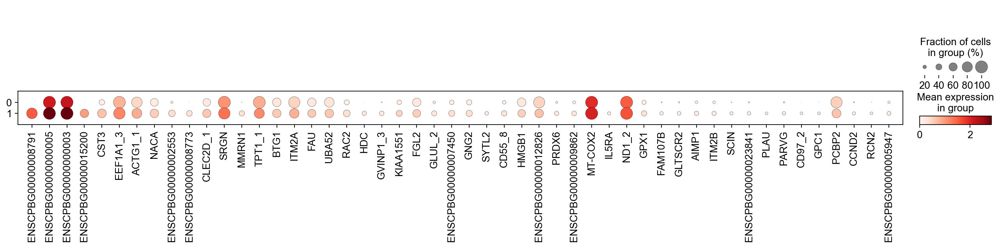

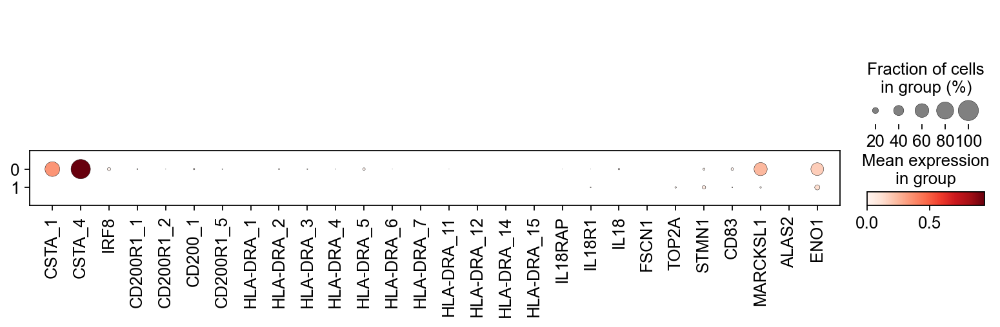

In [186]:
clusgene = list(pd.DataFrame(clusterm.uns['rank_genes_groups']['names']).head(200)['1'])
sc.pl.dotplot(clusterm,clusgene[:50],groupby='leiden',standard_scale=None)
possible_markers=['CSTA_1', 'CSTA_4', 'IRF8', 'CD200R1_1', 'CD200R1_2', 'CD200_1', 'CD200R1_5', 'HLA-DRA_1', 'HLA-DRA_2', 'HLA-DRA_3', 'HLA-DRA_4', 'HLA-DRA_5', 'HLA-DRA_6', 'HLA-DRA_7', 'HLA-DRA_11', 'HLA-DRA_12', 'HLA-DRA_14', 'HLA-DRA_15', 'IL18RAP', 'IL18R1', 'IL18', 'FSCN1', 'TOP2A', 'STMN1', 'CD83', 'MARCKSL1', 'ALAS2', 'ENO1']
sc.pl.dotplot(clusterm,possible_markers,groupby='leiden',standard_scale=None)


In [184]:
['CSTA_1', 'CSTA_4', 'IRF8', 'CD200R1_1', 'CD200R1_2', 'CD200_1', 'CD200R1_5', 'HLA-DRA_1', 'HLA-DRA_2', 'HLA-DRA_3', 'HLA-DRA_4', 'HLA-DRA_5', 'HLA-DRA_6', 'HLA-DRA_7', 'HLA-DRA_11', 'HLA-DRA_12', 'HLA-DRA_14', 'HLA-DRA_15', 'IL18RAP', 'IL18R1', 'IL18', 'FSCN1', 'TOP2A', 'STMN1', 'CD83', 'MARCKSL1', 'ALAS2', 'ENO1']

['CSTA_1',
 'CSTA_4',
 'IRF8',
 'CD200R1_1',
 'CD200R1_2',
 'CD200_1',
 'CD200R1_5',
 'HLA-DRA_1',
 'HLA-DRA_2',
 'HLA-DRA_3',
 'HLA-DRA_4',
 'HLA-DRA_5',
 'HLA-DRA_6',
 'HLA-DRA_7',
 'HLA-DRA_11',
 'HLA-DRA_12',
 'HLA-DRA_14',
 'HLA-DRA_15',
 'IL18RAP',
 'IL18R1',
 'IL18',
 'FSCN1',
 'TOP2A',
 'STMN1',
 'CD83',
 'MARCKSL1',
 'ALAS2',
 'ENO1']

In [168]:
sc.tl.dendrogram(clusterm,groupby='leiden')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


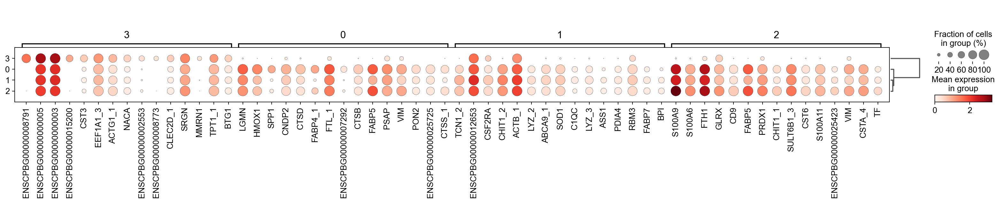

In [169]:
sc.pl.rank_genes_groups_dotplot(clusterm,n_genes=15, standard_scale=None)

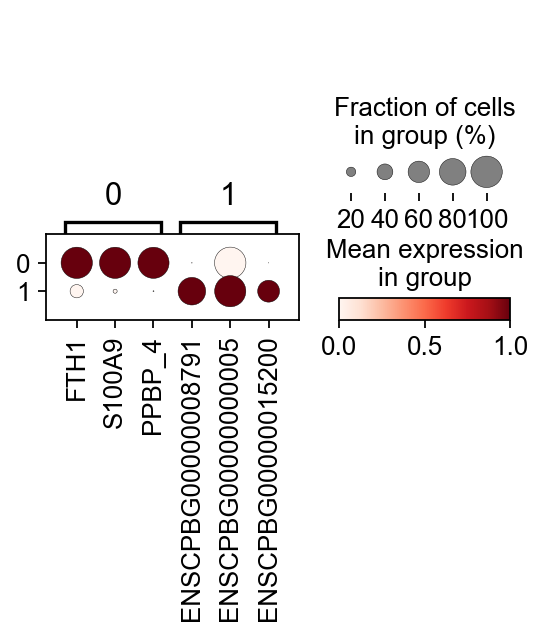

In [190]:
sc.pl.rank_genes_groups_dotplot(clusterm, n_genes=3, standard_scale='var')

In [220]:
clusterm.obs['cell_type'] = clusterm.obs.leiden.map(cell_types_m).astype('category')
clusterm.obs.drop(columns = 'leiden',inplace=True)

In [221]:
adata.obs.update(clusterm.obs)

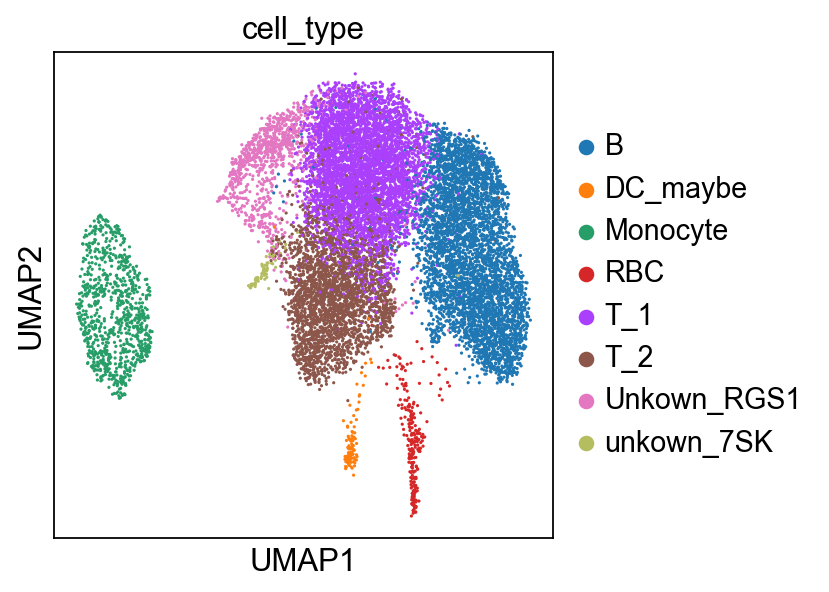

In [222]:
sc.pl.umap(adata,color='cell_type')

In [224]:
adata.obs.to_csv('turtle_meta.csv')

In [225]:
adata.write('turtle_processed.h5ad')

In [226]:
raw = sc.read()

This function returns a list of genes that are present in adata (markers for example) from an input of a general list.

In [9]:
def find_gene(gene):
    GENES= list(adata.raw.var.index[adata.raw.var.index.str.startswith(gene.upper())])
    return GENES

Finds genes that start with X

In [46]:
GENES= list(adata.raw.var.index[adata.raw.var.index.str.startswith(gene.upper())])
GENES

['CD207', 'CD247', 'CD200', 'CD200R1', 'CD226', 'CD2AP', 'CD2BP2', 'CD276']

In [252]:
find_gene('tcr')

[]

In [232]:
#Based on an overlay of turtle and komodo datasets
celldict = {'RBC': 'RBC',
 'T_2': 'T',
 'Monocyte': 'Monocyte',
 'T_1': 'T',
 'unkown_7SK': 'T',
 'B': 'B',
 'DC_maybe': 'Unkown_Lymphocyte',
 'Unkown_RGS1': 'Unkown_Lymphocyte'}

In [233]:
adata.obs.cell_type = adata.obs.cell_type.map(celldict).astype('category')

In [236]:
adata.obs.to_csv('updated_turtle_meta.csv')

# Using raw file

In [236]:
bdata = sc.read('Komodo_raw_with_metadata.h5ad')

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    Gene indices [13940, 13941] fell into a single bin: their normalized dispersion was set to 1.
    Decreasing `n_bins` will likely avoid this effect.
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


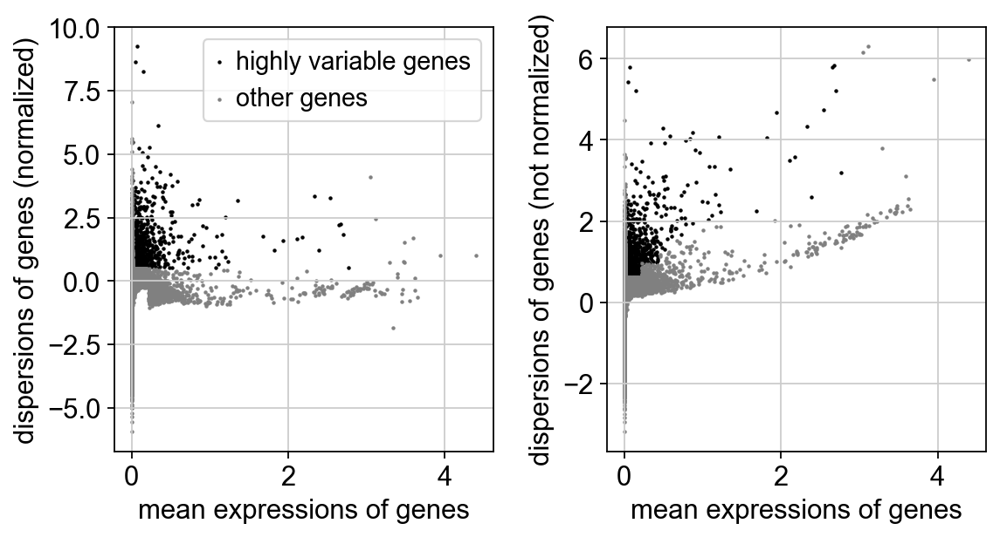

In [237]:
sc.pp.normalize_total(bdata)
sc.pp.log1p(bdata)
sc.pp.highly_variable_genes(bdata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(bdata)
bdata.raw = bdata

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
    ... clipping at max_value 10
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)
Memory usage: current 4.59 GB, difference -0.19 GB
computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 50
    computed neighbors (0:00:02)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


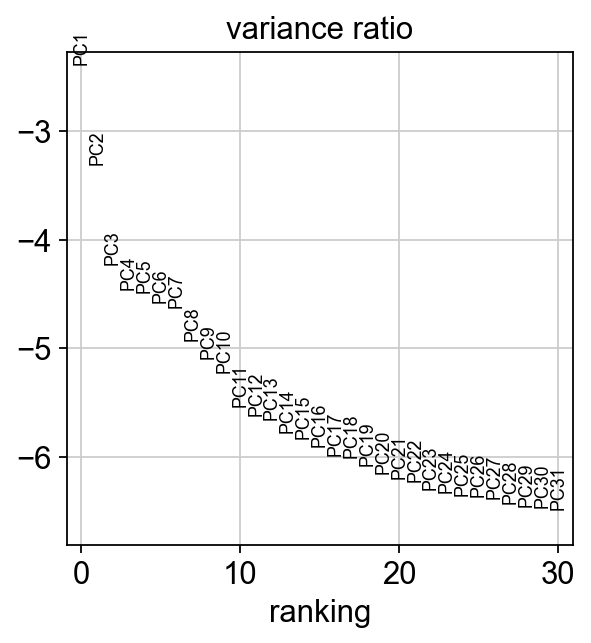

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:37)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:24)


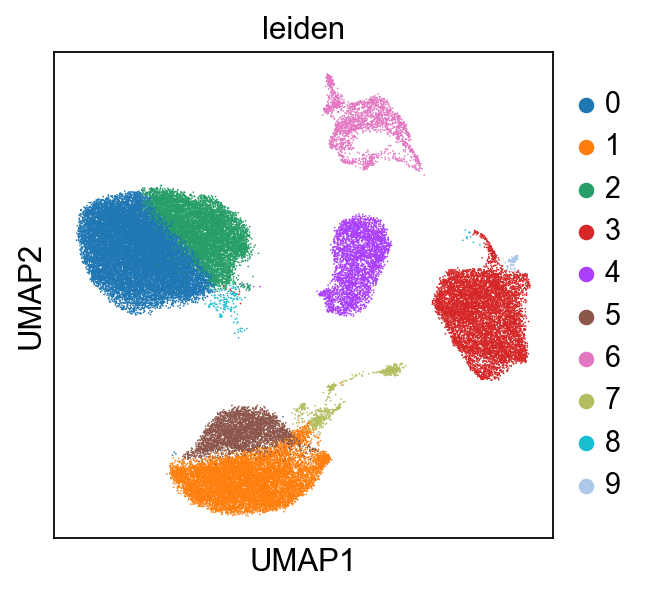

In [238]:
processing_batch(bdata,key='batch_key')

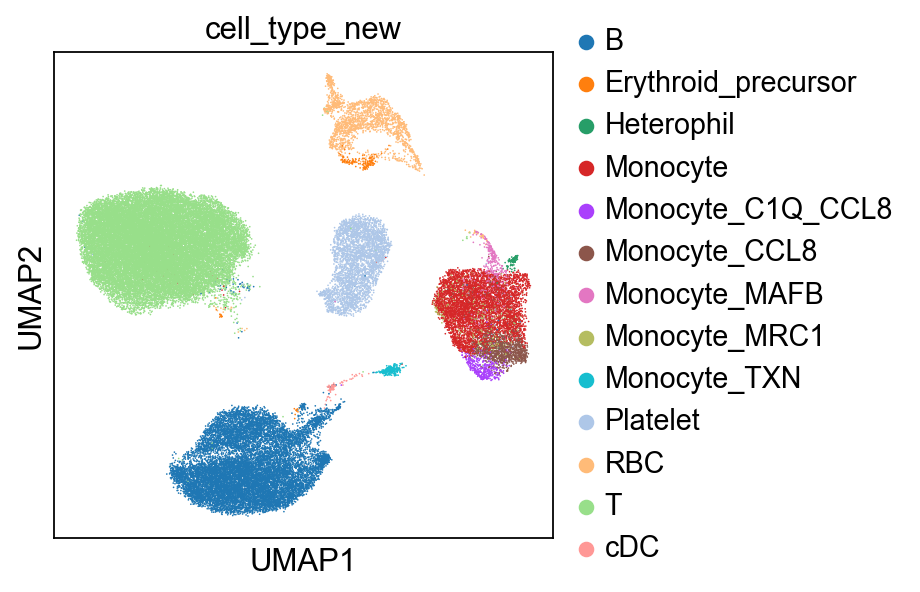

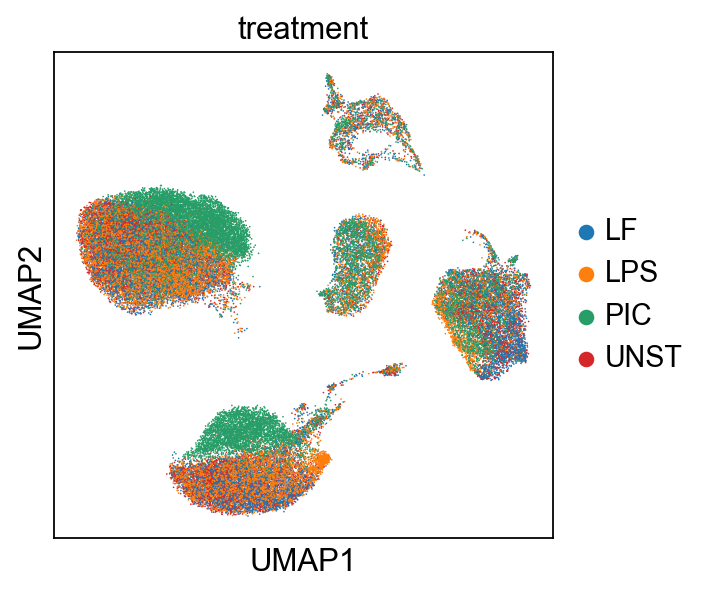

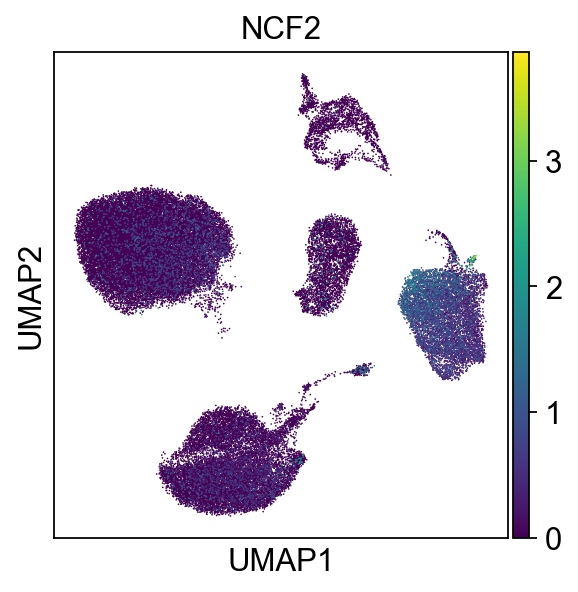

In [248]:
sc.pl.umap(bdata,color='cell_type_new')
sc.pl.umap(bdata,color='treatment')
sc.pl.umap(bdata,color='NCF2')

ranking genes


c:\users\tzachihnb5\appdata\local\programs\python\python39\lib\site-packages\anndata\compat\_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    consider 'treatment' groups:
    with sizes: [1362 1320 1306 1074]
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


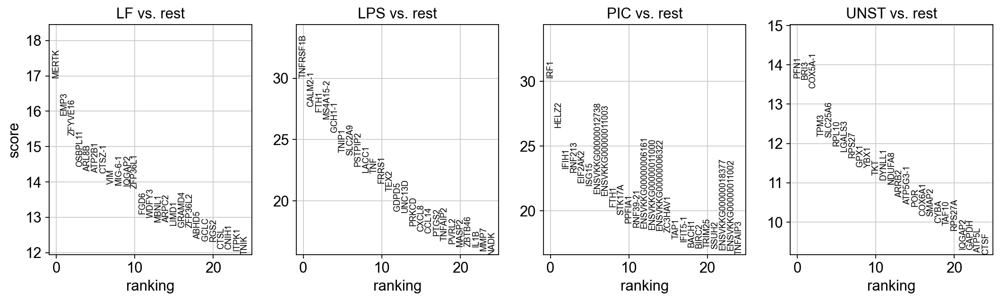

,LF,LPS,PIC,UNST
0,MERTK,TNFRSF1B,IRF1,PFN1
1,EMP3,CALM2-1,HELZ2,BRI3
2,ZFYVE16,FTH1,IFIH1,COX5A-1
3,OSBPL11,MS4A15-2,RNF213,TPM3
4,ARL8B,GCH1-1,EIF2AK2,SLC25A6
5,ATP2B1,TNIP1,ISG15,RPL10
6,CTSZ-1,SLC2A9,ENSVKKG00000012738,LGALS3
7,VIM,PSTPIP2,ENSVKKG00000011003,RPS27
8,MIG-6-1,LACC1,FTH1,GPX1
9,IQGAP2,TNF,STK17A,YBX1


In [270]:
rbc = adata[adata.obs.cell_type_new=='Monocyte']
sc.tl.rank_genes_groups(rbc, 'treatment', method='wilcoxon') # Can also be 'cell_type' once annotated
sc.pl.rank_genes_groups(rbc, n_genes=25, sharey=False)
pd.set_option("display.max_columns", None)
pd.DataFrame(rbc.uns['rank_genes_groups']['names']).head(20)

In [253]:
def find_gene(gene):
    GENES= list(bdata.raw.var.index[bdata.raw.var.index.str.startswith(gene.upper())])
    return GENES

In [257]:
find_gene('nkg')

['NKG7']

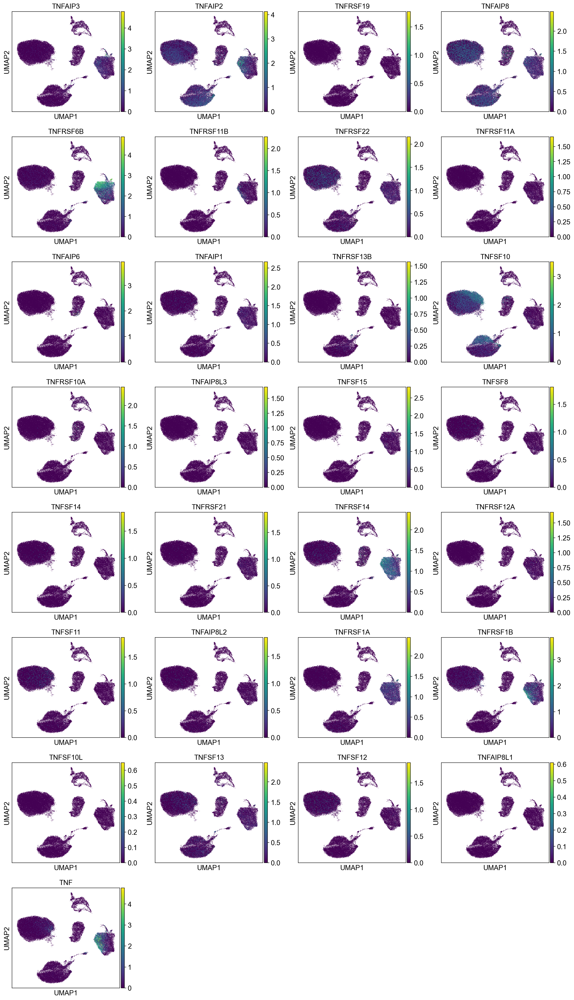

In [274]:
sc.pl.umap(bdata,color=find_gene('tnf'))

In [276]:
pd.set_option("display.max_rows", None)
[print(i) for i in pd.DataFrame(rbc.uns['rank_genes_groups']['names']).head(100).PIC.to_list()]

IRF1
HELZ2
IFIH1
RNF213
EIF2AK2
ISG15
ENSVKKG00000012738
ENSVKKG00000011003
FTH1
STK17A
PPFIA1
RNF39-21
ENSVKKG00000006161
ENSVKKG00000011000
ENSVKKG00000006322
ZC3HAV1
TAP1
IFIT5-1
BACH1
BIRC2
TRIM25
SSUH2
ENSVKKG00000018377
ENSVKKG00000011002
TNFAIP3
SNX10
HERC5
TNIP1
MBD2
SMCHD1
ETS2
MAST4
TEX2
TNF
MAFF
EHD4
IRF9
CD44
SERPINB2
IRG1
CXCL8
ALAS1
ENSVKKG00000000908
SAMD9L
BCL2L10
NFKBIA
ENSVKKG00000006162
BHLHE40
PNRC1
ENSVKKG00000005274
NADK
IER3
SDC4
RSAD2
IRAK2
TANK
TNFRSF14
ZCCHC11
PARP14-2
ATF3
IFT57
UNC13D
MOV10
TNFAIP2
EIF5B
RALGDS
ARID5B
USP18
TAP2-1
PSMA2
GSDMA
NFKBIZ
CMPK2
SRGAP2
MITD1
TFEC
HBEGF
STAT1
ACSL1
PIM2
GFPT2
IPCEF1
TRANK1
SERPINB1
RNF19B
AKAP13
PLEKHB2
RASGEF1A
PLEK
LARP4B
RAI14
GGH
DTX3L
CPNE8
ANKRD11
SLC40A1
DDX58
PARP12
STARD8
SYNGR2


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [277]:
find_gene('ccl8')

['CCL8_1', 'CCL8_2']